# Progressive Mirror Detection Dataset insights

In [1]:
import os
import random
from pathlib import Path
from natsort import natsorted
from collections import Counter
import cv2
import numpy as np
from tqdm import tqdm
from PIL import Image
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
SEED = 42
PROGRESS_BAR_LENGTH = 100

TRAIN_DATASET_PATH = Path("data") / "PMD" / "train"
TEST_DATASET_PATH = Path("data") / "PMD" / "test"

# Data analysis and preprocessing

## Load dataset

In [3]:
def get_images_and_masks_from_path(path):
    images = []
    masks = []

    for root, _, files in os.walk(path):
        if "image" in root and len(files) > 0:
            images.extend([os.path.join(root, f) for f in files])
        if "mask" in root and len(files) > 0:
            masks.extend([os.path.join(root, f) for f in files])

    return images, masks

In [4]:
if not TRAIN_DATASET_PATH.exists() or not TEST_DATASET_PATH.exists():
    raise FileNotFoundError(
        "The dataset file was not found in the data directory! Go to https://jiaying.link/cvpr2020-pgd/, download the split dataset and extract its content to a folder named 'data' in the root directory"
    )

# List images and masks in train and test
train_images, train_masks = get_images_and_masks_from_path(TRAIN_DATASET_PATH)
test_images, test_masks = get_images_and_masks_from_path(TEST_DATASET_PATH)

train_images = natsorted(train_images)
train_masks = natsorted(train_masks)
test_images = natsorted(test_images)
test_masks = natsorted(test_masks)

print(f"Train images: {len(train_images)}")
print(f"    e.g.: {train_images[:5]}")
print(f"Train masks: {len(train_masks)}")
print(f"    e.g.: {train_masks[:5]}")
print(f"Test images: {len(test_images)}")
print(f"    e.g.: {test_images[:5]}")
print(f"Test masks: {len(test_masks)}")
print(f"    e.g.: {test_masks[:5]}")

Train images: 5096
    e.g.: ['data\\PMD\\train\\image\\43.jpg', 'data\\PMD\\train\\image\\45.jpg', 'data\\PMD\\train\\image\\46.jpg', 'data\\PMD\\train\\image\\47.jpg', 'data\\PMD\\train\\image\\48.jpg']
Train masks: 5096
    e.g.: ['data\\PMD\\train\\mask\\43.png', 'data\\PMD\\train\\mask\\45.png', 'data\\PMD\\train\\mask\\46.png', 'data\\PMD\\train\\mask\\47.png', 'data\\PMD\\train\\mask\\48.png']
Test images: 572
    e.g.: ['data\\PMD\\test\\ADE20K\\image\\ADE_train_00000072.jpg', 'data\\PMD\\test\\ADE20K\\image\\ADE_train_00000082.jpg', 'data\\PMD\\test\\ADE20K\\image\\ADE_train_00000090.jpg', 'data\\PMD\\test\\ADE20K\\image\\ADE_train_00000101.jpg', 'data\\PMD\\test\\ADE20K\\image\\ADE_train_00000134.jpg']
Test masks: 571
    e.g.: ['data\\PMD\\test\\ADE20K\\mask\\ADE_train_00000082.png', 'data\\PMD\\test\\ADE20K\\mask\\ADE_train_00000090.png', 'data\\PMD\\test\\ADE20K\\mask\\ADE_train_00000101.png', 'data\\PMD\\test\\ADE20K\\mask\\ADE_train_00000134.png', 'data\\PMD\\test\\ADE20

In [5]:
def check_image_mask_association(image_list, mask_list):
    missing_images = []
    missing_masks = []

    for image in image_list:
        if image.replace(".jpg", ".png").replace("image", "mask") not in mask_list:
            missing_masks.append(image)
    for mask in mask_list:
        if mask.replace(".png", ".jpg").replace("mask", "image") not in image_list:
            missing_images.append(mask)

    return missing_masks, missing_images

In [6]:
train_missing_masks, train_missing_images = check_image_mask_association(
    train_images, train_masks
)
test_missing_masks, test_missing_images = check_image_mask_association(
    test_images, test_masks
)

for missing_mask in train_missing_masks:
    print(
        f"Image file {missing_mask} does not have a mask file with the same name in the mask directory !"
    )
for missing_image in train_missing_images:
    print(
        f"Mask file {missing_image} does not have an image file with the same name in the image directory !"
    )
for missing_mask in test_missing_masks:
    print(
        f"Image file {missing_mask} does not have a mask file with the same name in the mask directory !"
    )
for missing_image in test_missing_images:
    print(
        f"Mask file {missing_image} does not have an image file with the same name in the image directory !"
    )

Image file data\PMD\test\ADE20K\image\ADE_train_00000072.jpg does not have a mask file with the same name in the mask directory !


In [7]:
for missing_mask in train_missing_masks:
    train_images.remove(missing_mask)
for missing_image in train_missing_images:
    train_masks.remove(missing_image)
for missing_mask in test_missing_masks:
    test_images.remove(missing_mask)
for missing_image in test_missing_images:
    test_masks.remove(missing_image)

print(f"Train images: {len(train_images)}")
print(f"    e.g.: {train_images[:5]}")
print(f"Train masks: {len(train_masks)}")
print(f"    e.g.: {train_masks[:5]}")
print(f"Test images: {len(test_images)}")
print(f"    e.g.: {test_images[:5]}")
print(f"Test masks: {len(test_masks)}")
print(f"    e.g.: {test_masks[:5]}")

Train images: 5096
    e.g.: ['data\\PMD\\train\\image\\43.jpg', 'data\\PMD\\train\\image\\45.jpg', 'data\\PMD\\train\\image\\46.jpg', 'data\\PMD\\train\\image\\47.jpg', 'data\\PMD\\train\\image\\48.jpg']
Train masks: 5096
    e.g.: ['data\\PMD\\train\\mask\\43.png', 'data\\PMD\\train\\mask\\45.png', 'data\\PMD\\train\\mask\\46.png', 'data\\PMD\\train\\mask\\47.png', 'data\\PMD\\train\\mask\\48.png']
Test images: 571
    e.g.: ['data\\PMD\\test\\ADE20K\\image\\ADE_train_00000082.jpg', 'data\\PMD\\test\\ADE20K\\image\\ADE_train_00000090.jpg', 'data\\PMD\\test\\ADE20K\\image\\ADE_train_00000101.jpg', 'data\\PMD\\test\\ADE20K\\image\\ADE_train_00000134.jpg', 'data\\PMD\\test\\ADE20K\\image\\ADE_train_00000203.jpg']
Test masks: 571
    e.g.: ['data\\PMD\\test\\ADE20K\\mask\\ADE_train_00000082.png', 'data\\PMD\\test\\ADE20K\\mask\\ADE_train_00000090.png', 'data\\PMD\\test\\ADE20K\\mask\\ADE_train_00000101.png', 'data\\PMD\\test\\ADE20K\\mask\\ADE_train_00000134.png', 'data\\PMD\\test\\ADE20

## Data insights

### Display a few images

In [8]:
def display_sample_images_and_masks(image_lists, n=5, title_prefix=""):
    image_samples = random.sample(image_lists, n)

    weight_color = np.array([1, 0, 0], dtype=np.uint8)

    for i, image_sample in enumerate(image_samples):
        plt.figure(layout="compressed", figsize=(12, 12))

        plt.subplot(1, 3, 1)
        image = cv2.cvtColor(cv2.imread(image_sample), cv2.COLOR_BGR2RGB)
        plt.imshow(image)

        plt.subplot(1, 3, 2)
        mask = cv2.cvtColor(
            cv2.imread(image_sample.replace(".jpg", ".png").replace("image", "mask")),
            cv2.COLOR_BGR2RGB,
        )
        plt.imshow(mask)

        plt.subplot(1, 3, 3)
        masked_image = cv2.addWeighted(image, 0.5, mask * weight_color, 0.5, 0.0)
        plt.imshow(masked_image)

        plt.suptitle(f"{title_prefix}Sample #{i + 1}")
    plt.show()

TRAIN SAMPLES


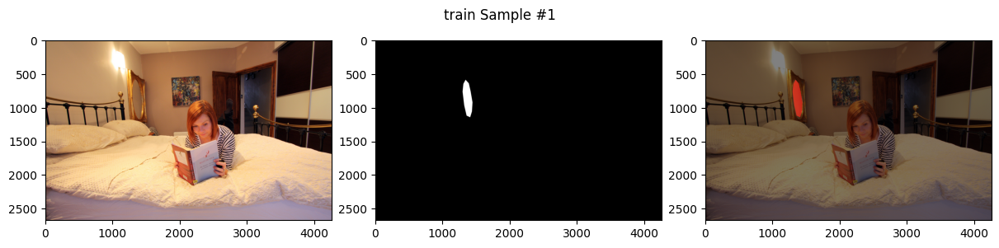

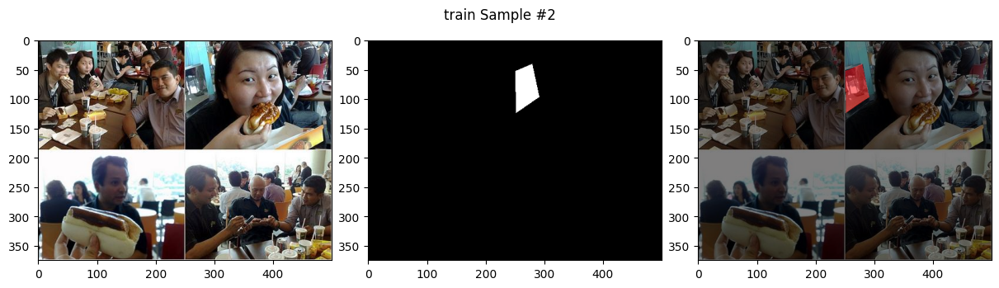

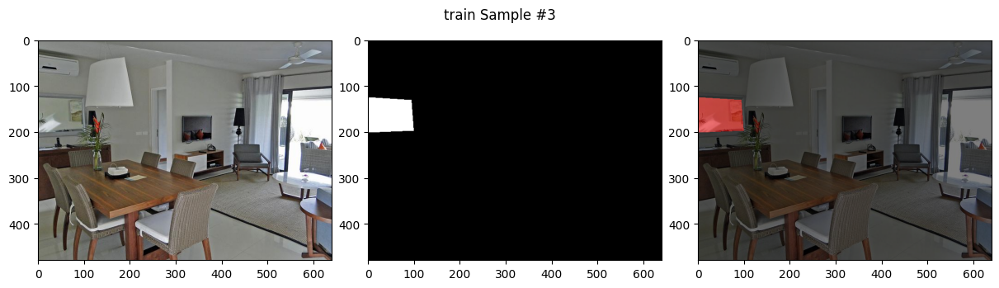

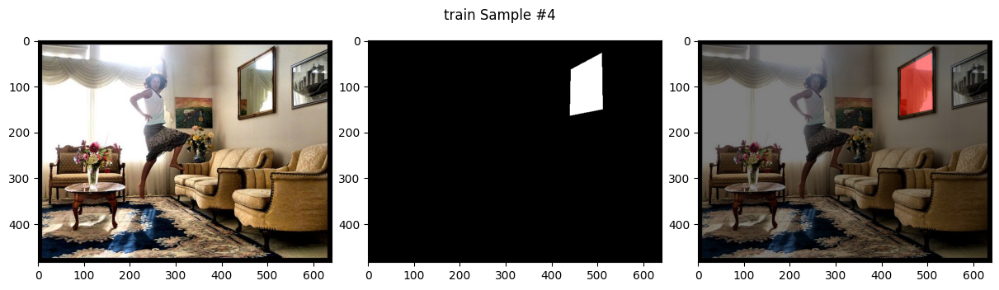

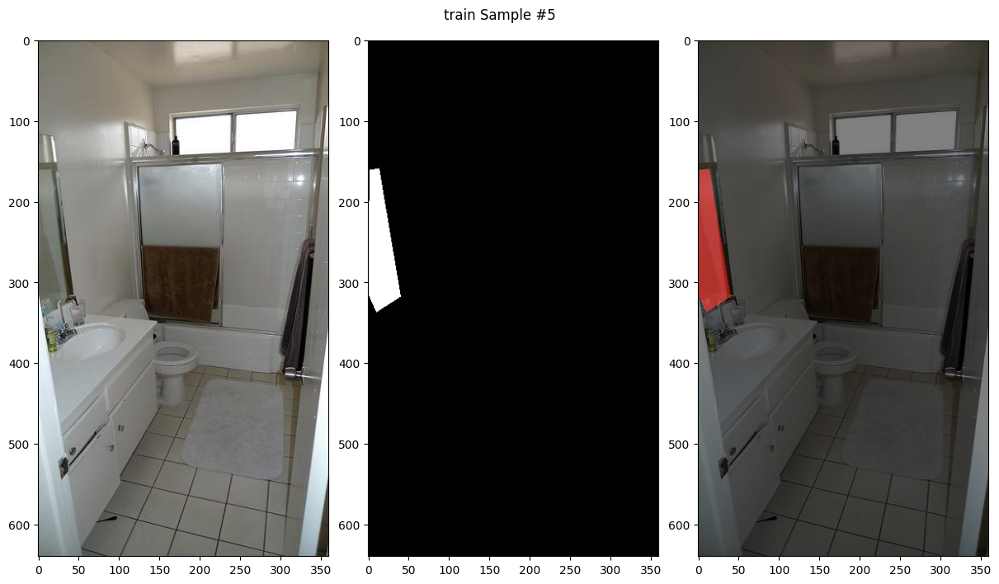

TEST SAMPLES


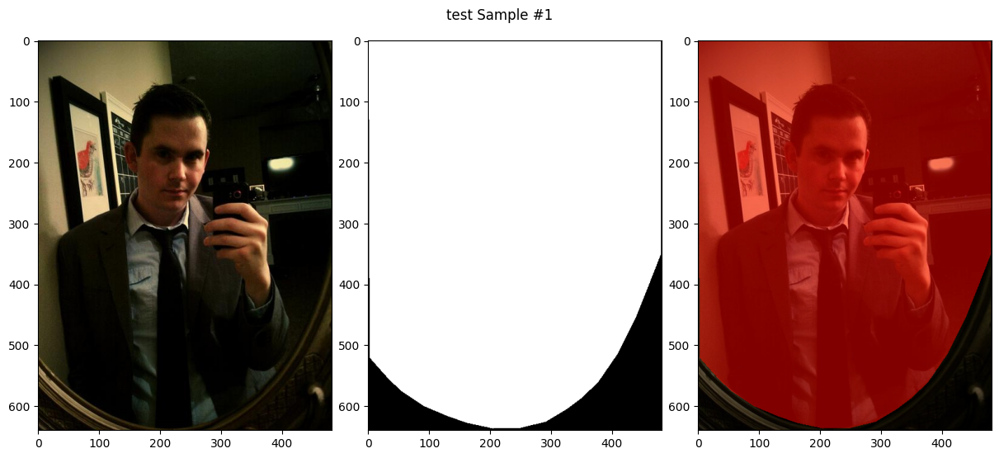

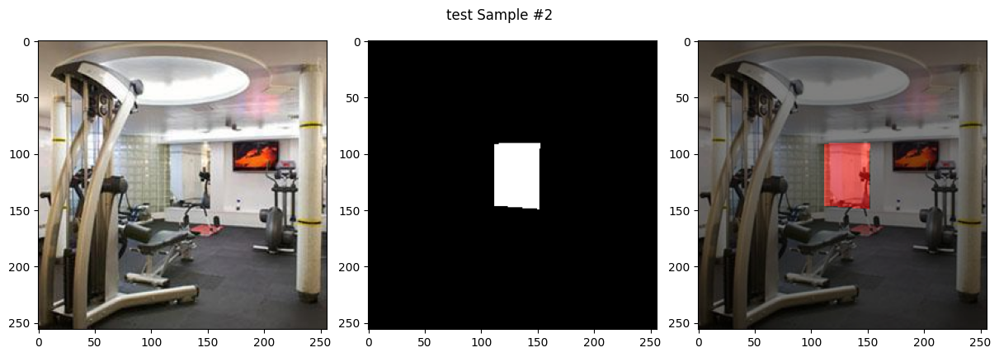

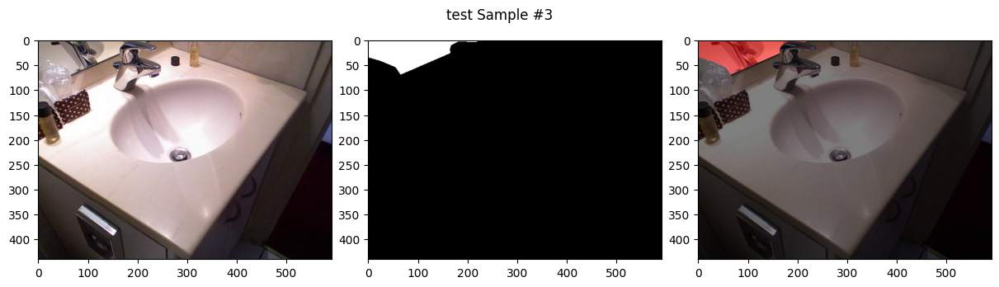

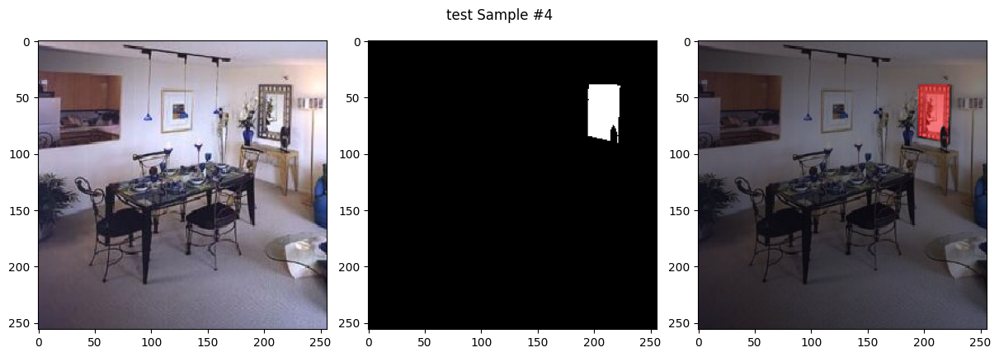

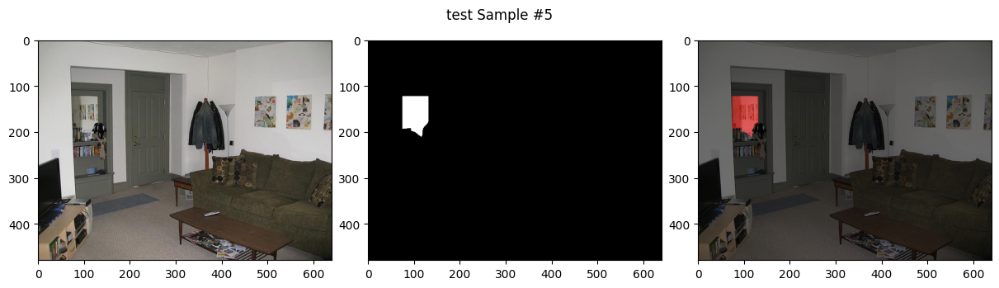

In [9]:
random.seed(SEED)

print("TRAIN SAMPLES")
display_sample_images_and_masks(train_images, n=5, title_prefix=f"train ")

print("TEST SAMPLES")
display_sample_images_and_masks(test_images, n=5, title_prefix=f"test ")

### Explore dataset

In [10]:
def display_sample_images(image_lists, n=100):
    image_samples = random.sample(image_lists, n)

    n_cols = int(np.min([10, np.floor(np.sqrt(n))]))
    n_rows = int(np.ceil(n / n_cols))

    plt.figure(layout="compressed", figsize=(n_cols * 2, n_rows * 2))
    for i, image_sample in enumerate(image_samples):
        plt.subplot(n_rows, n_cols, i + 1)
        image = cv2.cvtColor(cv2.imread(image_sample), cv2.COLOR_BGR2RGB)
        plt.imshow(image)
        plt.axis('off')

    plt.show()

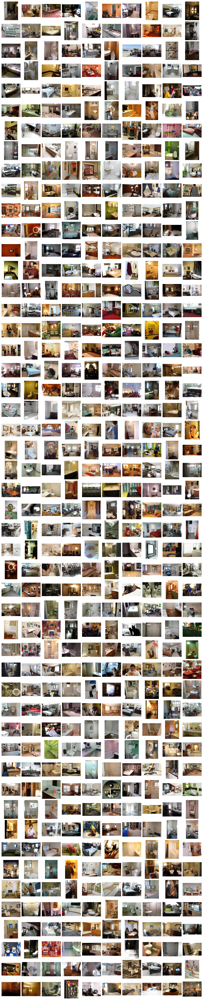

In [11]:
display_sample_images(train_images, n=500)

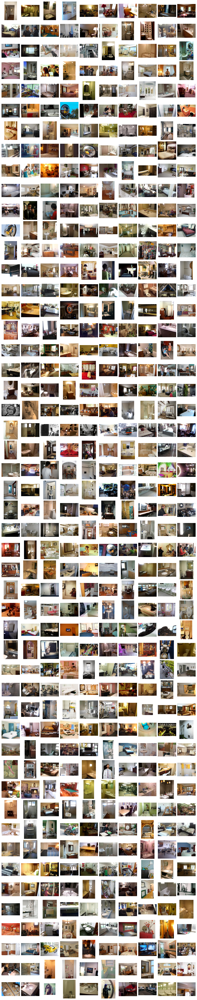

In [12]:
display_sample_images(test_images, n=500)

### Display distribution of mirror count in image

In [13]:
def display_mirror_count_distribution(mask_list, title_prefix=""):
    counts = []

    for mask in mask_list:
        mask = cv2.imread(mask, cv2.IMREAD_GRAYSCALE)
        n_labels, _, _, _ = cv2.connectedComponentsWithStats(mask, connectivity=8)
        counts.append(n_labels - 1)

    counter = Counter(counts)

    plt.figure(layout="compressed", figsize=(12, 4))
    sns.barplot(x=counter.keys(), y=counter.values())
    plt.xticks(rotation=90)
    plt.title(f"{title_prefix}Number of mirrors per image")
    plt.show()

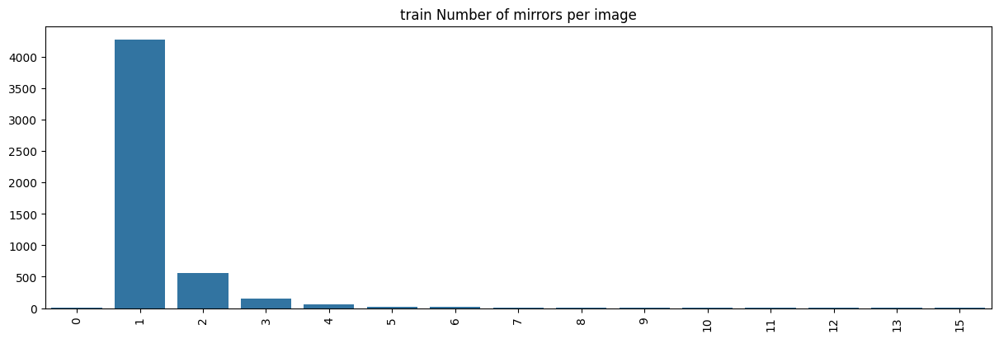

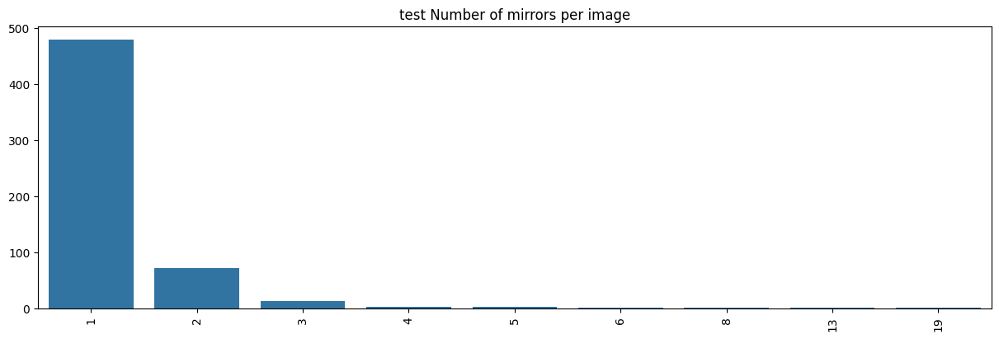

In [14]:
display_mirror_count_distribution(train_masks, title_prefix="train ")
display_mirror_count_distribution(test_masks, title_prefix="test ")

### Display distribution of image dimensions

In [15]:
def display_image_dimensions_distribution(image_list, title_prefix=""):
    dimensions = []

    for image in image_list:
        im = Image.open(image)
        dimensions.append(im.size)

    counter = Counter(dimensions)
    most_commons = counter.most_common(30)

    plt.figure(layout="compressed", figsize=(12, 4))
    sns.barplot(
        x=[str(key) for key, _ in most_commons], y=[value for _, value in most_commons]
    )
    plt.xticks(rotation=90)
    plt.title(f"{title_prefix}Image dimensions")
    plt.show()

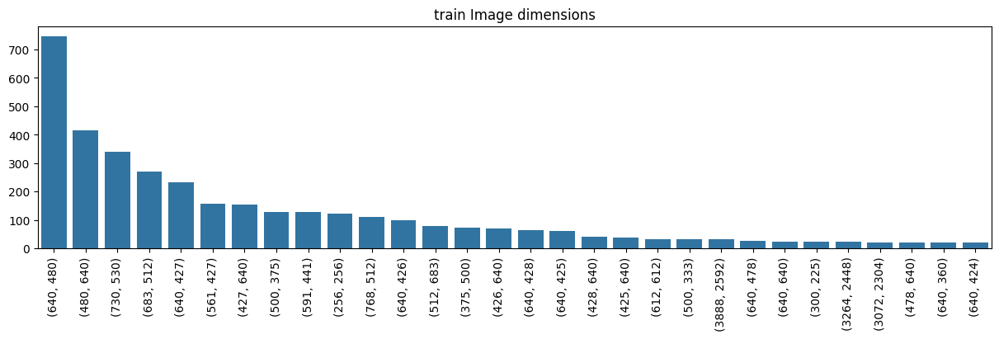

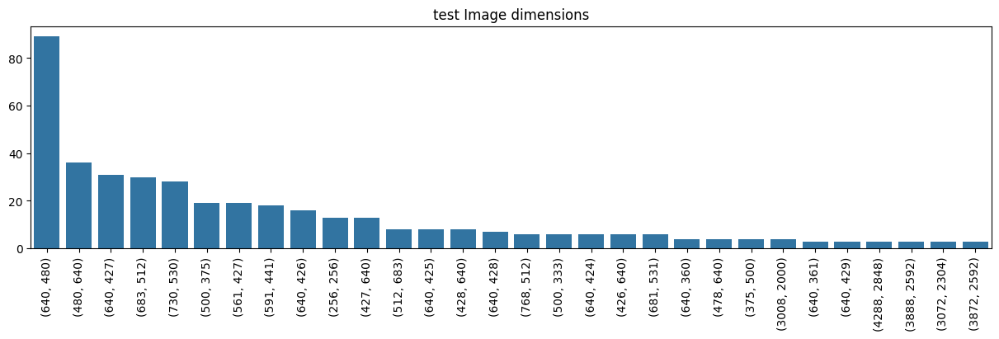

In [16]:
display_image_dimensions_distribution(train_images, title_prefix="train ")
display_image_dimensions_distribution(test_images, title_prefix="test ")

### Display distribution of aspect ratio

In [17]:
def display_aspect_ratio_distribution(image_list, title_prefix=""):
    aspect_ratios = []

    for image in image_list:
        im = Image.open(image)
        width, height = im.size
        aspect_ratios.append(width / height)

    plt.figure(layout="compressed", figsize=(12, 4))
    sns.histplot(aspect_ratios)
    plt.title(f"{title_prefix}Aspect ratios")
    plt.show()

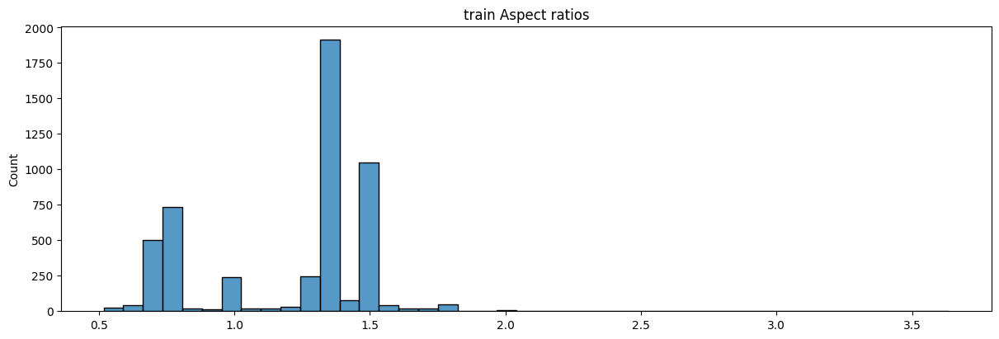

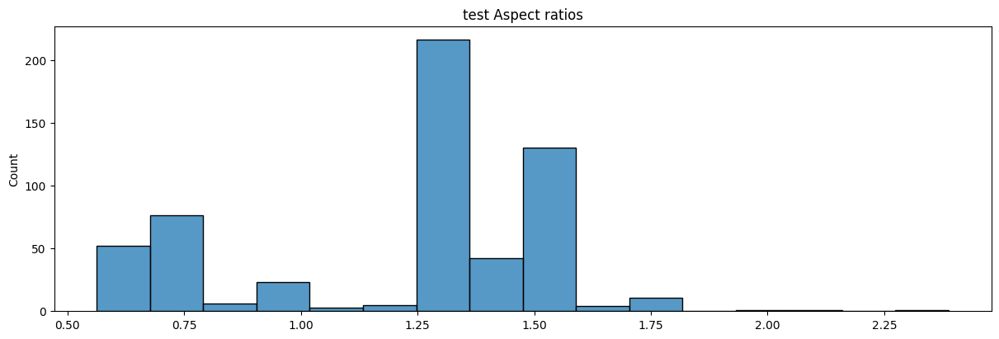

In [18]:
display_aspect_ratio_distribution(train_images, title_prefix="train ")
display_aspect_ratio_distribution(test_images, title_prefix="test ")

### Display distribution of mirror surface / image surface

In [19]:
def display_surface_distribution(mask_list, title_prefix=""):
    mirror_surface_ratios = []

    for mask_file in mask_list:
        mask = cv2.imread(mask_file, cv2.IMREAD_GRAYSCALE)
        mirror_surface_ratios.append(np.mean(mask) / 255.0)

    plt.figure(layout="compressed", figsize=(12, 4))
    sns.histplot(mirror_surface_ratios, binrange=(0, 1))
    plt.title(f"{title_prefix}A_mirror/A_image")
    plt.xlim(0, 1)
    plt.show()

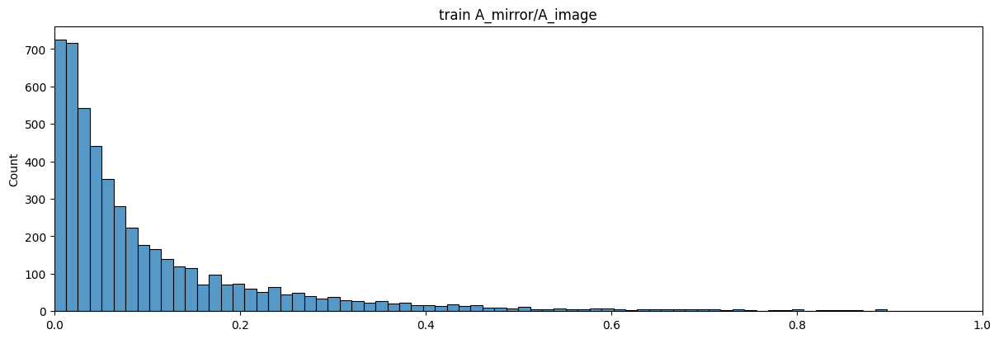

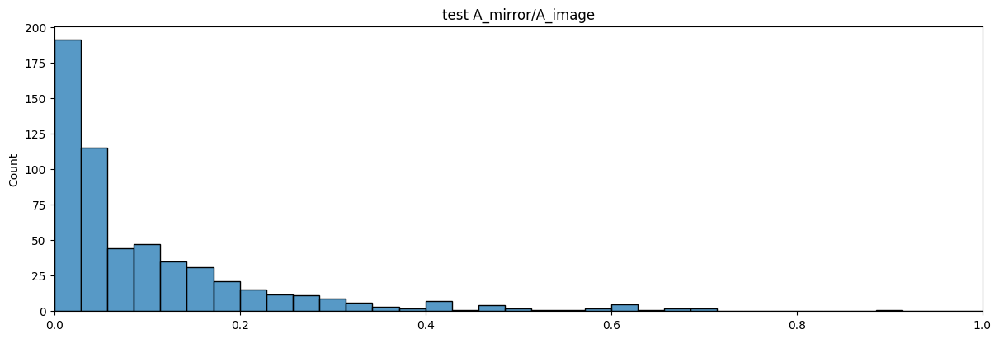

In [20]:
display_surface_distribution(train_masks, title_prefix="train ")
display_surface_distribution(test_masks, title_prefix="test ")

### Display mean of all masks

In [21]:
def display_mean_mask(mask_list, title_prefix=""):
    base_image = np.zeros((640, 640), dtype=float)

    for mask_file in mask_list:
        mask = cv2.imread(mask_file, cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, (640, 640)) / 255.0
        base_image = cv2.addWeighted(base_image, 1, mask, 1 / len(mask_list), 0.0)

    plt.figure(layout="compressed", figsize=(12, 12))
    plt.imshow(base_image)
    plt.title(f"{title_prefix}Mean mask")
    plt.show()

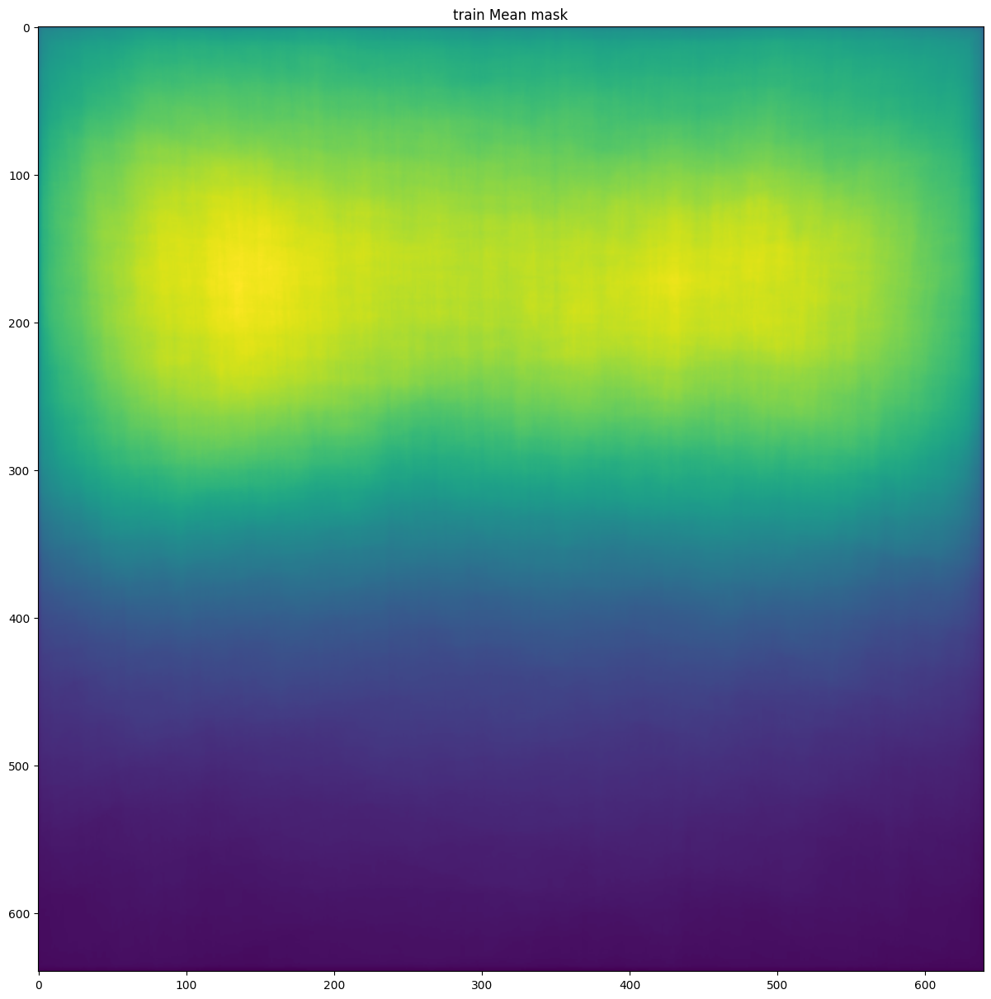

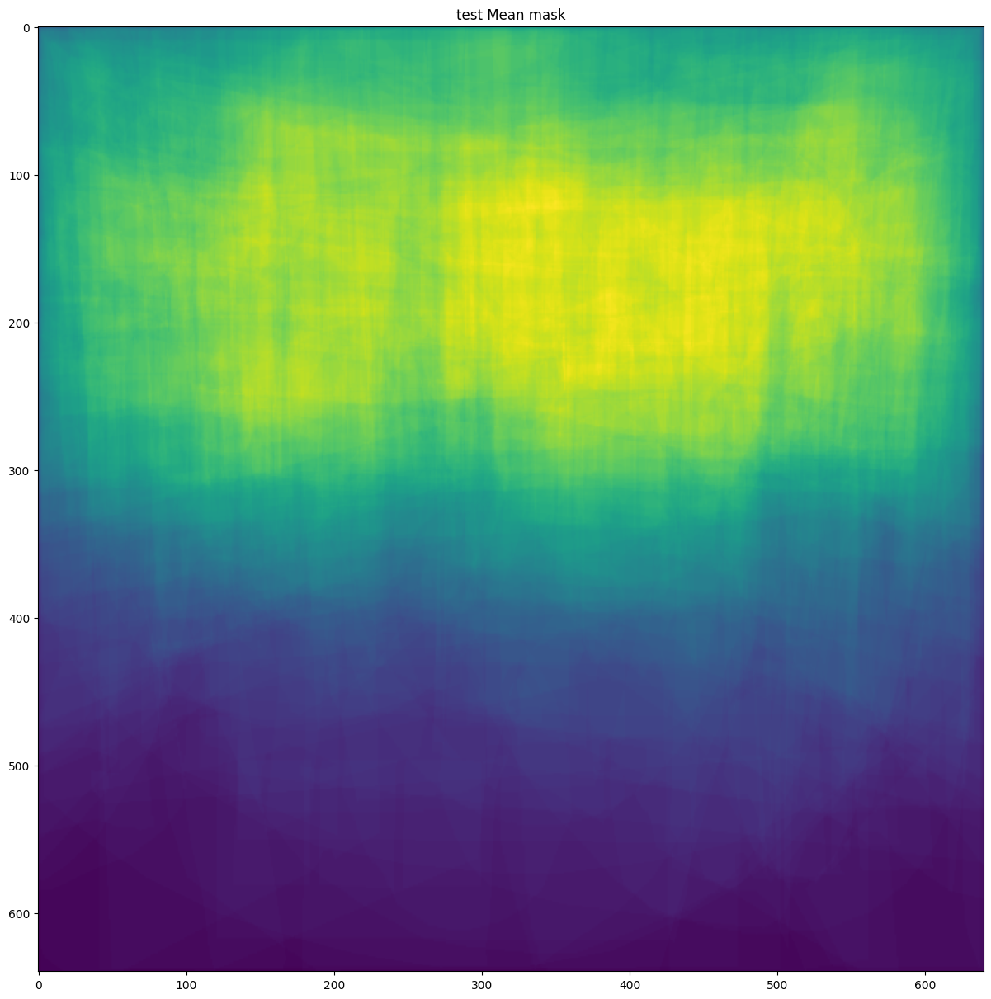

In [22]:
display_mean_mask(train_masks, title_prefix="train ")
display_mean_mask(test_masks, title_prefix="test ")

### Compute input image mean and standard deviation of RGB channels

In [23]:
def compute_closest_estimation_mean_std(image_list):
    mean = np.zeros((3,), dtype=float)
    mean_temp = np.zeros((0, 3), dtype=int)
    n_divs = 0
    for image_file in tqdm(image_list):
        image = cv2.imread(image_file)
        mean_temp = np.concatenate([mean_temp, image.reshape(-1, 3)])
        if mean_temp.shape[0] > len(image_list):
            n = mean_temp.shape[0] // len(image_list)
            n_divs += n
            mean += np.sum(mean_temp[:n * len(image_list)], axis=0) / len(image_list)
            mean_temp = mean_temp[n * len(image_list):]
    mean += np.sum(mean_temp, axis=0) / len(image_list)
    mean /= n_divs

    std = np.zeros((3,), dtype=float)
    std_temp = np.zeros((0, 3), dtype=int)
    n_divs = 0
    for image_file in tqdm(image_list):
        image = cv2.imread(image_file)
        std_temp = np.concatenate([std_temp, image.reshape(-1, 3)])
        if std_temp.shape[0] > len(image_list):
            n = std_temp.shape[0] // len(image_list)
            n_divs += n
            std += np.sum(np.square(std_temp[:n * len(image_list)] - mean), axis=0) / len(image_list)
            std_temp = std_temp[n * len(image_list):]
    std += np.sum(np.square(std_temp - mean), axis=0) / len(image_list)
    std = np.sqrt(std / n_divs)

    return mean, std


def compute_mean_std_resized(image_list, image_size):
    mean = np.zeros((3,), dtype=float)
    for image_file in tqdm(image_list):
        image = cv2.resize(cv2.imread(image_file), image_size)
        mean += np.mean(image, axis=(0, 1))
    mean /= len(image_list)

    std = np.zeros((3,), dtype=float)
    for image_file in tqdm(image_list):
        image = cv2.resize(cv2.imread(image_file), image_size)
        std += np.mean(np.square(image - mean), axis=(0, 1))
    std = np.sqrt(std / len(image_list))

    return mean, std

In [24]:
train_mean, train_std = compute_closest_estimation_mean_std(train_images)
print(f"train: mean={train_mean / 255.0} std={train_std / 255.0}")

test_mean, test_std = compute_closest_estimation_mean_std(test_images)
print(f"test: mean={test_mean / 255.0} std={test_std / 255.0}")

100%|██████████| 5096/5096 [02:35<00:00, 32.81it/s] 


train: mean=[0.35584922 0.42847384 0.49746954] std=[0.26618722 0.25926806 0.2629341 ]


100%|██████████| 571/571 [00:17<00:00, 32.66it/s] 

test: mean=[0.37685802 0.44364619 0.51997646] std=[0.27060104 0.26542712 0.26420465]


In [25]:
train_mean, train_std = compute_mean_std_resized(train_images, (640, 640))
print(f"train (640, 640): mean={train_mean / 255.0} std={train_std / 255.0}")

test_mean, test_std = compute_mean_std_resized(test_images, (640, 640))
print(f"test (640, 640): mean={test_mean / 255.0} std={test_std / 255.0}")

100%|██████████| 5096/5096 [01:13<00:00, 69.18it/s]


train (640, 640): mean=[0.39383583 0.45319526 0.5091343 ] std=[0.26529468 0.25812329 0.25829774]


100%|██████████| 571/571 [00:08<00:00, 69.32it/s]

test (640, 640): mean=[0.38701524 0.44865304 0.50649344] std=[0.26743637 0.2609903  0.26099815]
